In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
import numpy as np

In [13]:
df = pd.read_csv("stroke_data.csv")

# EDA + Preprocessing

In [14]:
df.head(10)

,sex,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1.0,63.0,0,1,1,4,1,228.69,36.6,1,1
1,1.0,42.0,0,1,1,4,0,105.92,32.5,0,1
2,0.0,61.0,0,0,1,4,1,171.23,34.4,1,1
3,1.0,41.0,1,0,1,3,0,174.12,24.0,0,1
4,1.0,85.0,0,0,1,4,1,186.21,29.0,1,1
5,1.0,55.0,1,1,1,4,0,70.09,27.4,0,1
6,0.0,82.0,0,0,0,4,1,94.39,22.8,0,1
7,0.0,17.0,1,0,1,4,0,80.43,29.7,0,1
8,1.0,31.0,0,1,1,2,0,120.46,36.8,1,1
9,0.0,55.0,0,0,1,4,1,104.51,27.3,1,1


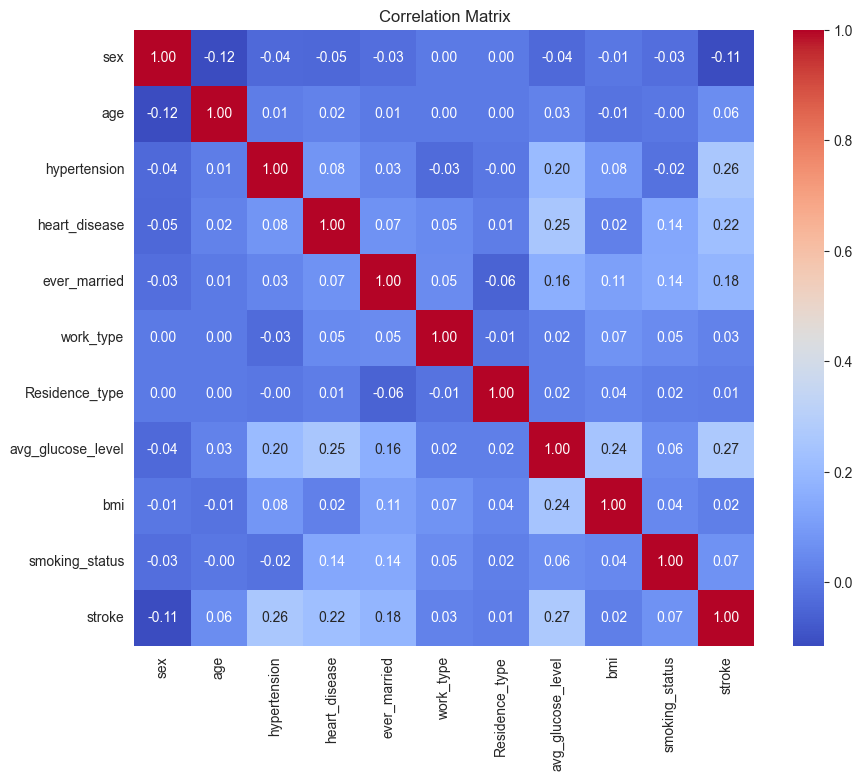

In [15]:
plt.figure(figsize=(10, 8))
sns.heatmap(df.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

In [16]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40910 entries, 0 to 40909
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   sex                40907 non-null  float64
 1   age                40910 non-null  float64
 2   hypertension       40910 non-null  int64  
 3   heart_disease      40910 non-null  int64  
 4   ever_married       40910 non-null  int64  
 5   work_type          40910 non-null  int64  
 6   Residence_type     40910 non-null  int64  
 7   avg_glucose_level  40910 non-null  float64
 8   bmi                40910 non-null  float64
 9   smoking_status     40910 non-null  int64  
 10  stroke             40910 non-null  int64  
dtypes: float64(4), int64(7)
memory usage: 3.4 MB
None


In [17]:
df.dropna(axis=0, how='any', inplace=True)

In [18]:
for column in df.columns:
    print(f"Unique values of '{column}':")

    print(df[column].unique())
    print()

Unique values of 'sex':
[1. 0.]

Unique values of 'age':
[ 63.  42.  61.  41.  85.  55.  82.  17.  31.  39.  26.  19.  78.  45.
  50.  53.  71.  64.  75.  67.  40.  23.  33.  65.  83.  79.  62.  58.
  34.  27.  68.  52.  49.  13.  60.  24.  11.  47.  70.  38.  59.  36.
  77.  54.  93.  29.  51.  21.  56.  20.  46.  72.  37.  18.  66.  25.
  57.  16.  80.  28.  84.  44.  43.  76.  48.   8.  14.  88.  69.  22.
  15.  32.  35.  73.  81.  74.  30.  86.  92.   5.  91.   6.  87.   7.
   9.  12.  10.  89.  90.   4.   1.   3.  -2.  -5.  -4.  -3.  -1.   2.
   0.  -6.  -9.  95. 103.  94.  98.  96. 102. 101.  97.  99. 100.]

Unique values of 'hypertension':
[0 1]

Unique values of 'heart_disease':
[1 0]

Unique values of 'ever_married':
[1 0]

Unique values of 'work_type':
[4 3 2 1 0]

Unique values of 'Residence_type':
[1 0]

Unique values of 'avg_glucose_level':
[228.69 105.92 171.23 ... 125.2   82.99 166.29]

Unique values of 'bmi':
[36.6 32.5 34.4 24.  29.  27.4 22.8 29.7 36.8 27.3 28.2 30.9 

In [19]:
df = df.drop(df[df.age < 0].index)
len(df.index)


40849

In [20]:
df.loc[df['age'] < 5, 'smoking_status'] = 0

In [21]:
for column in df.columns:
    print(f"Unique values of '{column}':")

    print(df[column].unique())
    print()

Unique values of 'sex':
[1. 0.]

Unique values of 'age':
[ 63.  42.  61.  41.  85.  55.  82.  17.  31.  39.  26.  19.  78.  45.
  50.  53.  71.  64.  75.  67.  40.  23.  33.  65.  83.  79.  62.  58.
  34.  27.  68.  52.  49.  13.  60.  24.  11.  47.  70.  38.  59.  36.
  77.  54.  93.  29.  51.  21.  56.  20.  46.  72.  37.  18.  66.  25.
  57.  16.  80.  28.  84.  44.  43.  76.  48.   8.  14.  88.  69.  22.
  15.  32.  35.  73.  81.  74.  30.  86.  92.   5.  91.   6.  87.   7.
   9.  12.  10.  89.  90.   4.   1.   3.   2.   0.  95. 103.  94.  98.
  96. 102. 101.  97.  99. 100.]

Unique values of 'hypertension':
[0 1]

Unique values of 'heart_disease':
[1 0]

Unique values of 'ever_married':
[1 0]

Unique values of 'work_type':
[4 3 2 1 0]

Unique values of 'Residence_type':
[1 0]

Unique values of 'avg_glucose_level':
[228.69 105.92 171.23 ... 125.2   82.99 166.29]

Unique values of 'bmi':
[36.6 32.5 34.4 24.  29.  27.4 22.8 29.7 36.8 27.3 28.2 30.9 37.5 25.8
 37.8 22.4 48.9 26.6 27.2

In [22]:
df.head(10)

,sex,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1.0,63.0,0,1,1,4,1,228.69,36.6,1,1
1,1.0,42.0,0,1,1,4,0,105.92,32.5,0,1
2,0.0,61.0,0,0,1,4,1,171.23,34.4,1,1
3,1.0,41.0,1,0,1,3,0,174.12,24.0,0,1
4,1.0,85.0,0,0,1,4,1,186.21,29.0,1,1
5,1.0,55.0,1,1,1,4,0,70.09,27.4,0,1
6,0.0,82.0,0,0,0,4,1,94.39,22.8,0,1
7,0.0,17.0,1,0,1,4,0,80.43,29.7,0,1
8,1.0,31.0,0,1,1,2,0,120.46,36.8,1,1
9,0.0,55.0,0,0,1,4,1,104.51,27.3,1,1


In [28]:
from sklearn.model_selection import train_test_split
X = df.drop('stroke', axis=1)
y = df["stroke"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42, stratify=y)

# PCA

In [34]:
pca = PCA()
X_pca = pca.fit_transform(X)


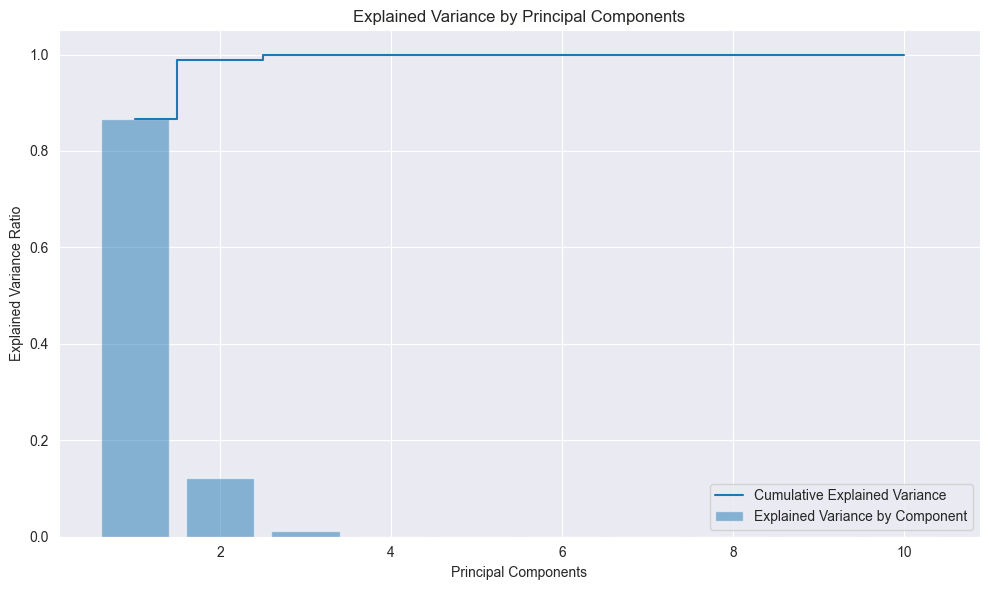

In [36]:
# Аналіз explained variance для кожної компоненти
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Візуалізація explained variance
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Explained Variance by Component')
plt.step(range(1, len(cumulative_variance) + 1), cumulative_variance, where='mid',
         label='Cumulative Explained Variance')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by Principal Components')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [37]:
pca_2d = PCA(n_components=2)
X_2d = pca_2d.fit_transform(X)

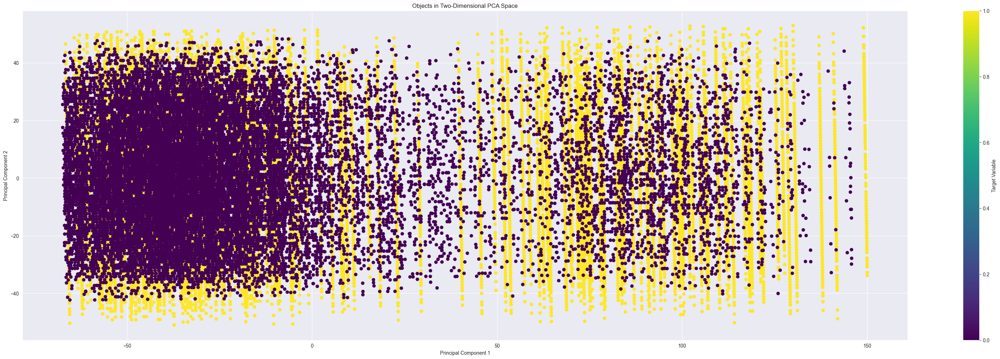

In [40]:
# Plot objects in the new space with color based on target variable
plt.figure(figsize=(40, 12))
plt.scatter(X_2d[:, 0], X_2d[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Objects in Two-Dimensional PCA Space')
plt.colorbar(label='Target Variable')
plt.show()


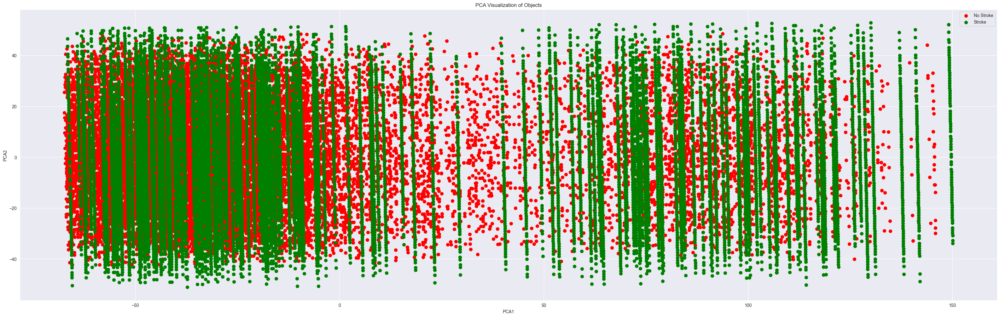

In [42]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Ініціалізуємо PCA з двома компонентами
pca = PCA(n_components=2)

# Застосовуємо PCA до навчальних даних
X_pca = pca.fit_transform(X)

# Створюємо DataFrame для зручності візуалізації
pca_df = pd.DataFrame(data=X_pca, columns=['PCA1', 'PCA2'])

# Додаємо цільову змінну до pca_df для кольорової розмітки на графіку
pca_df['target'] = y.values

# Побудова візуалізації об'єктів у новому просторі
plt.figure(figsize=(40, 12))
targets = [0, 1]  # Класи цільової змінної (0 - без інсульту, 1 - інсульт)
colors = ['r', 'g']  # Кольори для кожного класу

for target, color in zip(targets, colors):
    indices_to_keep = pca_df['target'] == target
    plt.scatter(pca_df.loc[indices_to_keep, 'PCA1'],
                pca_df.loc[indices_to_keep, 'PCA2'],
                c=color,
                s=50)

plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.title('PCA Visualization of Objects')
plt.legend(['No Stroke', 'Stroke'])
plt.grid(True)
plt.show()


tsne

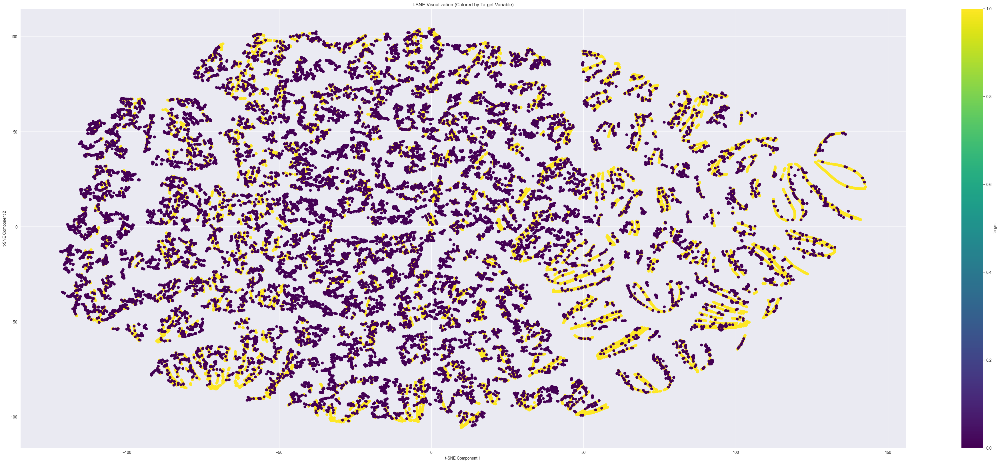

In [44]:
from sklearn.manifold import TSNE

# Ініціалізуємо модель t-SNE з 2 компонентами
tsne = TSNE(n_components=2, random_state=42)


# Зменшення вимірності та візуалізація результату
X_tsne = tsne.fit_transform(X)
plt.figure(figsize=(50, 20))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='viridis')
plt.title('t-SNE Visualization (Colored by Target Variable)')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.colorbar(label='Target')
plt.show()

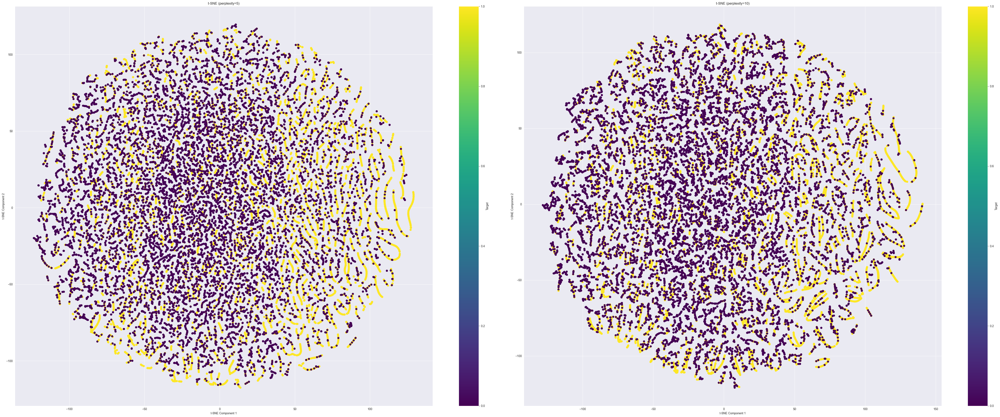

In [45]:

perplexity_values = [5, 10]

plt.figure(figsize=(50, 20))
for i, perplexity in enumerate(perplexity_values, 1):
    tsne_model = TSNE(n_components=2, perplexity=perplexity, random_state=42)
    X_tsne = tsne_model.fit_transform(X)
    
    plt.subplot(1, 2, i)
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='viridis')
    plt.title(f't-SNE (perplexity={perplexity})')
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.colorbar(label='Target')

plt.tight_layout()
plt.show()

umap


G:\Ilya\ML\venv\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


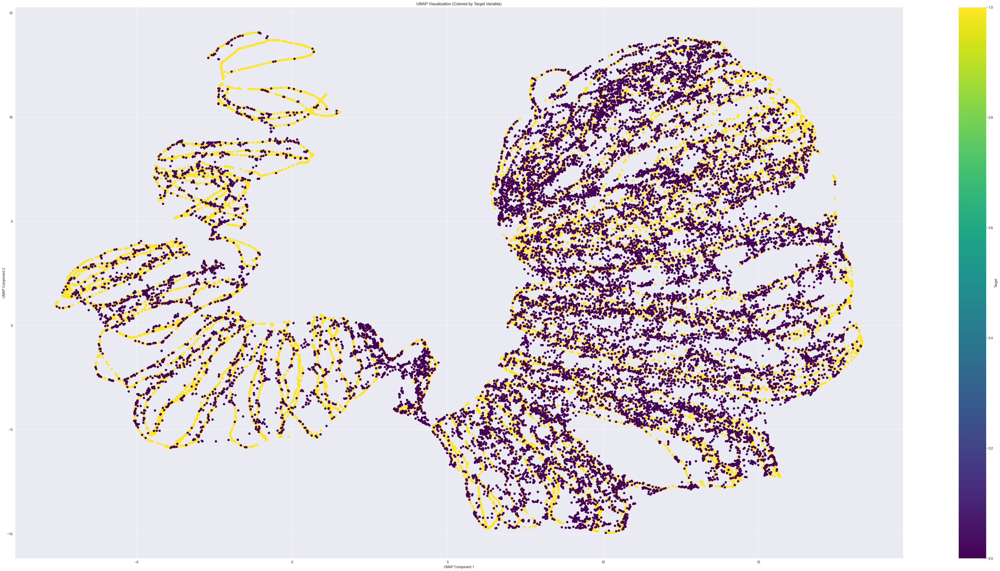

In [50]:
import umap

# Ініціалізуємо модель UMAP з 2 компонентами
umap_model = umap.UMAP(n_components=2, random_state=42)

# Зменшення вимірності та візуалізація результату
X_umap = umap_model.fit_transform(X)
plt.figure(figsize=(60, 30))
plt.scatter(X_umap[:, 0], X_umap[:, 1], c=y, cmap='viridis')
plt.title('UMAP Visualization (Colored by Target Variable)')
plt.xlabel('UMAP Component 1')
plt.ylabel('UMAP Component 2')
plt.colorbar(label='Target')
plt.show()

G:\Ilya\ML\venv\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


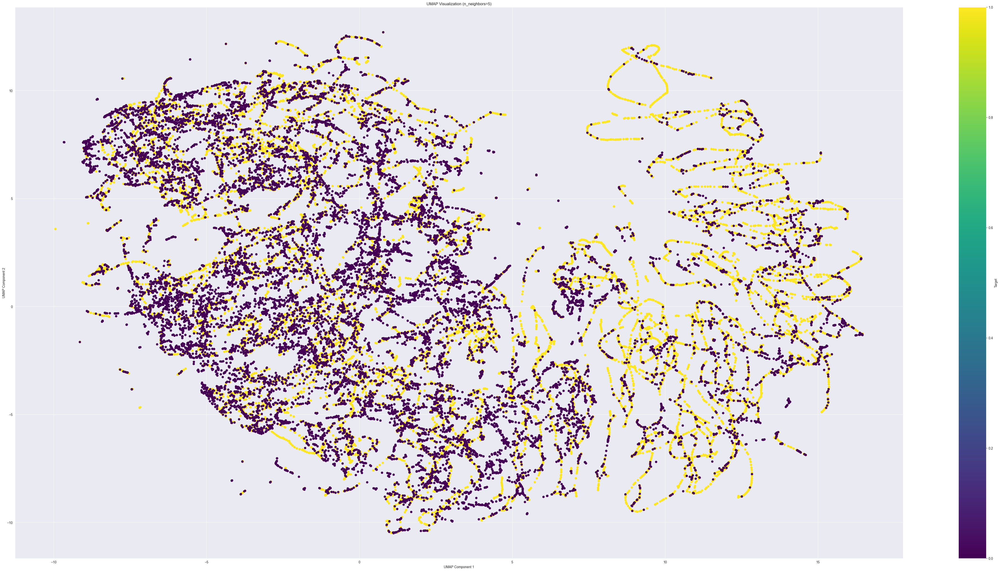

G:\Ilya\ML\venv\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


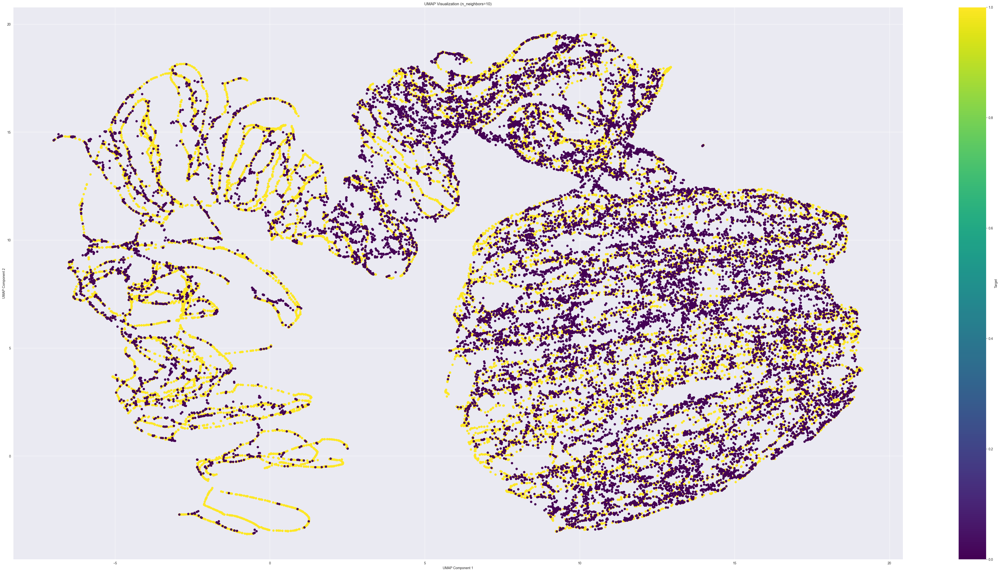

G:\Ilya\ML\venv\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


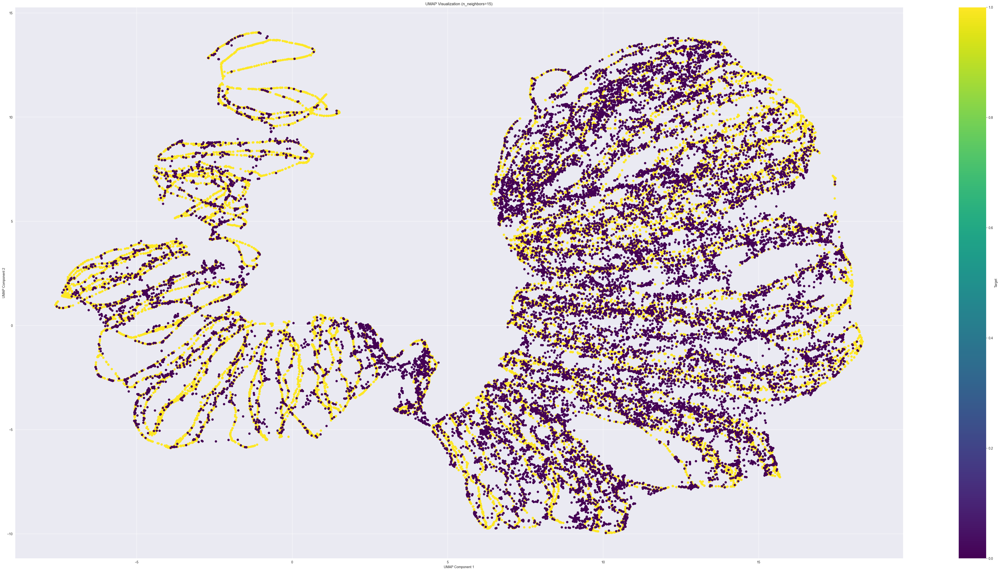

In [52]:
# Список значень n_neighbors, які ви бажаєте перевірити
n_neighbors_values = [5, 10]

# Побудова UMAP та візуалізація для кожного значення n_neighbors
for n_neighbors in n_neighbors_values:
    umap_model = umap.UMAP(n_components=2, n_neighbors=n_neighbors, random_state=42)
    X_umap = umap_model.fit_transform(X)
    
    plt.figure(figsize=(60, 30))
    plt.scatter(X_umap[:, 0], X_umap[:, 1], c=y, cmap='viridis')
    plt.title(f'UMAP Visualization (n_neighbors={n_neighbors})')
    plt.xlabel('UMAP Component 1')
    plt.ylabel('UMAP Component 2')
    plt.colorbar(label='Target')
    plt.show()